# Acoustic source localization using Bayesian optimization and a Gaussian process surrogate model

In [9]:
from pathlib import Path
import sys
sys.path.insert(0, Path.cwd() / "Source")

from ax.utils.notebook.plotting import init_notebook_plotting, render
from ax.service.ax_client import AxClient
from IPython.display import Video
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

# from BOGP import collate, figures, swellex

init_notebook_plotting()

ROOT = Path.home() / "Research" / "Projects" / "BOGP"
FIGURE_PATH = ROOT / "Reports" / "JASA" / "figures"
SAVEFIG_KWARGS = {"dpi": 200, "facecolor": "white", "bbox_inches": "tight"}
AMBSURF_PATH = ROOT / "Data" / "SWELLEX96" / "VLA" / "selected" / "multifreq" / "148.0-166.0-201.0-235.0-283.0-338.0-388.0"

[INFO 03-20 09:14:46] ax.utils.notebook.plotting: Injecting Plotly library into cell. Do not overwrite or delete cell.


## 1. Bayesian Optimization in Action

### 1-D Case: Range Estimation

tensor([0.6027, 0.3414, 0.8705, 0.7264, 0.9620, 0.0503, 0.6666, 0.4745, 0.2379,
        0.9495])

### 2-D Case: Localization

## 2. Simulations

### Examine ambiguity surfaces for different values of SNR

In [60]:
from tritonoa.io import read_ssp
from tritonoa.kraken import run_kraken
from tritonoa.sp import added_wng, beamformer, snrdb_to_sigma

RANGE_TRUE = 1

z_data, c_data, _ = read_ssp(
    ROOT / "Data" / "SWELLEX96" / "CTD" / "i9606.prn", 0, 3, header=None
)
z_data = np.append(z_data, 217).tolist()
c_data = np.append(c_data, c_data[-1]).tolist()

# Define environment parameters
environment = {
    # 1. General
    "title": "SWELLEX96_SIM",
    "model": "KRAKEN",
    "tmpdir": "./Notebooks/tmp",
    # 2. Top medium (halfspace)
    # 3. Layered media
    "layerdata": [
        {"z": z_data, "c_p": c_data, "rho": 1},
        {"z": [217, 240], "c_p": [1572.3, 1593.0], "rho": 1.76, "a_p": 0.2},
        {"z": [240, 1040], "c_p": [1881, 3245], "rho": 2.06, "a_p": 0.06},
    ],
    # 4. Bottom medium
    "bot_opt": "A",
    "bot_c_p": 5200,
    "bot_rho": 2.66,
    "bot_a_p": 0.02,
    # 5. Speed constraints
    "clow": 0,
    "chigh": 1650,
    # 6. Receiver parameters
    "rec_z": np.linspace(94.125, 212.25, 64).tolist(),
    # "tilt": -1
    # 7. Source parameters
    "rec_r": RANGE_TRUE,
    "src_z": 60.0,
    "freq": 201.0
}

def run_beamformer(environment, p, snr):
    sigma = snrdb_to_sigma(snr)
    noise = added_wng(p.shape, sigma=sigma, cmplx=True)
    p += noise
    K = p.dot(p.conj().T)

    rvec = np.linspace(0.01, 10, 501)
    B = np.zeros_like(rvec)
    p_rep = run_kraken(environment | {"rec_r": rvec})
    for rr, _ in enumerate(rvec):
        B[rr] = beamformer(K, p_rep[:,rr], atype="cbf").item()

    return rvec, B


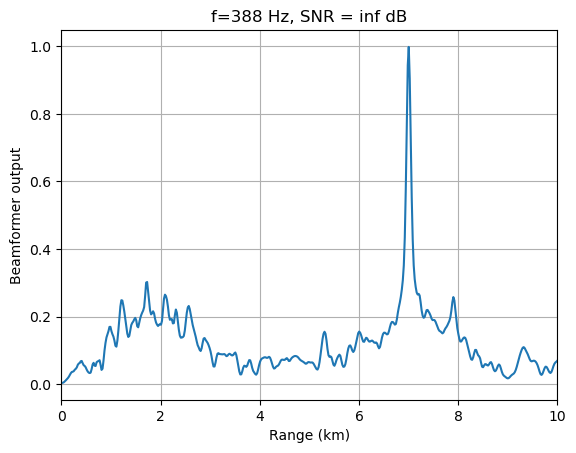

In [115]:
frequencies = [148, 166, 201, 235, 283, 338, 388]
# frequencies = [201]

snr = np.inf

B = np.zeros((len(frequencies), 501))
for ff, freq in enumerate(frequencies):
    environment["freq"] = freq
    p1 = run_kraken(environment | {"rec_r": 7.0})
    p2 = 0
    # p2 = run_kraken(environment | {"rec_r": 2.0})
    p = p1 + p2
    p /= np.linalg.norm(p)
    rvec, B[ff] = run_beamformer(environment, p, snr)

B = np.mean(B, axis=0)
    
fig, ax = plt.subplots()
ax.plot(rvec, B)
ax.set_xlabel("Range (km)")
ax.set_ylabel("Beamformer output")
ax.set_title(f"f={environment['freq']} Hz, SNR = {snr} dB")
ax.grid(True)
ax.set_xlim(0, 10)
# ax.set_ylim(0, 1.2)
plt.show()

# B = np.zeros((len(frequencies), 501))
# for ff, freq in enumerate(frequencies):
#     environment["freq"] = freq
#     p1 = run_kraken(environment | {"rec_r": 1.0})
#     p2 = 0
#     # p2 = run_kraken(environment | {"rec_r": 2.0})
#     p = p1 + p2
#     p /= np.linalg.norm(p)
#     rvec, B[ff] = run_beamformer(environment, p, snr)

# B = np.product(B, axis=0)
    
# fig, ax = plt.subplots()
# ax.plot(rvec, B)
# ax.set_xlabel("Range (km)")
# ax.set_ylabel("Beamformer output")
# ax.set_title(f"f={environment['freq']} Hz, SNR = {snr} dB")
# ax.grid(True)
# ax.set_xlim(0, 10)
# # ax.set_ylim(0, 1.2)
# plt.show()


### Range Estimation

Read in simulation results and format the data frame.

In [2]:
sim_dir = ROOT / "Data" / "range_estimation" / "simulation"
serial = "serial_230217"
df = pd.read_csv(sim_dir / serial / "results" / "collated.csv")

Plot optimization history and range estimation error.

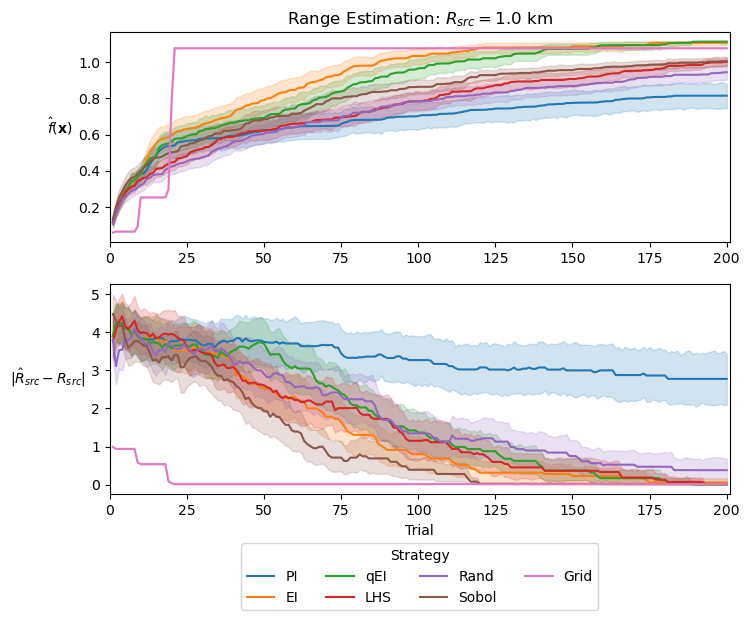

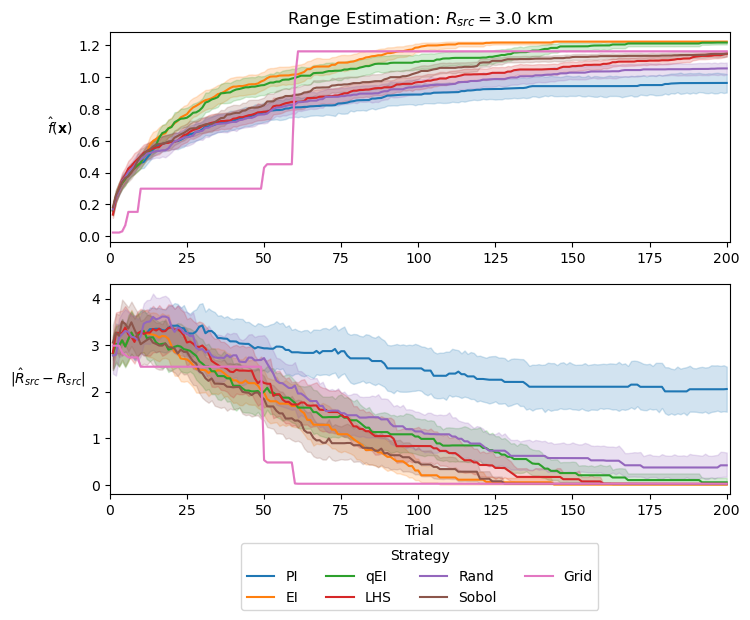

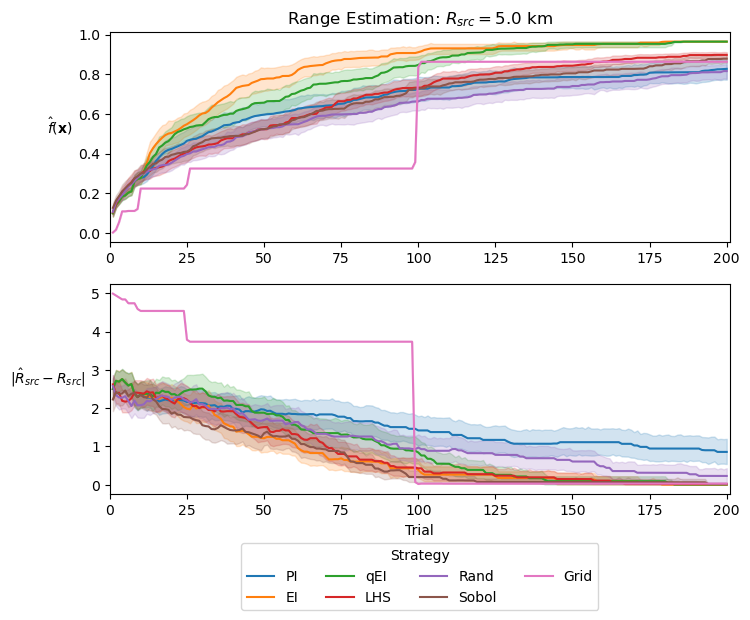

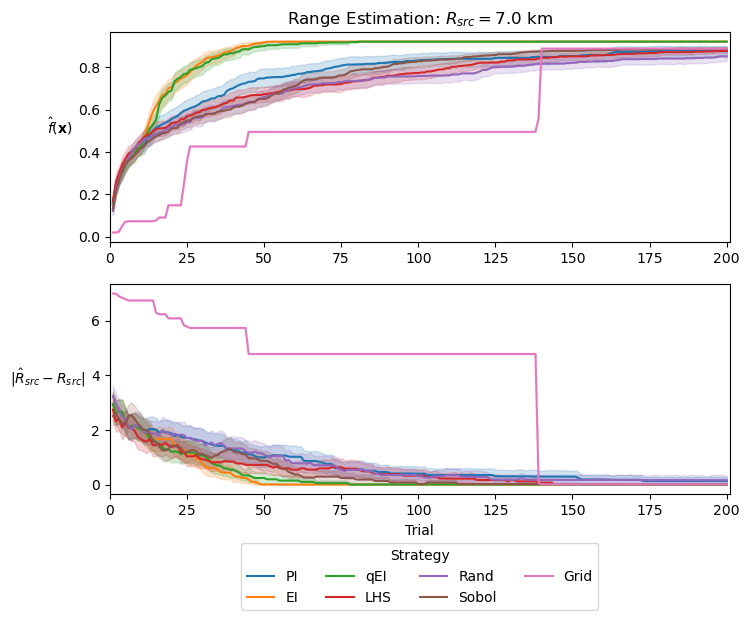

In [3]:
for r in sorted(df["range"].unique()):
    selection = df["range"] == r

    fig, axs = plt.subplots(figsize=(8, 6), nrows=2)

    ax = axs[0]
    sns.lineplot(
        data=df[selection],
        x="trial_index",
        y="best_values",
        hue="strategy",
        ax=ax,
        legend=None,
    )
    ax.set_xlim([0, 201])
    ax.set_xlabel(None)
    ax.set_ylabel("$\hat{f}(\mathbf{x})$", rotation=0, ha="right")
    ax.set_title(f"Range Estimation: $R_{{src}} = {r}$ km")

    ax = axs[1]
    sns.lineplot(
        data=df[selection], x="trial_index", y="best_range_error", hue="strategy", ax=ax
    )
    ax.set_xlim([0, 201])
    sns.move_legend(
        ax, "upper center", bbox_to_anchor=(0.5, -0.2), ncol=4, title="Strategy"
    )
    ax.set_xlabel("Trial")
    ax.set_ylabel("$\\vert \hat{R}_{src}- R_{src} \\vert$", rotation=0, ha="right")
    ax.set_title(None)

    fig.savefig(
        FIGURE_PATH.parents[1] / "Figures" / f"perf_hist_rs_{r}km.png", **SAVEFIG_KWARGS
    )
    plt.show()

### Localization

Read in simulation results and format the data frame.

In [13]:
sim_dir = ROOT / "Data" / "localization" / "simulation"
serial = "serial_multifreq_full2"
df = pd.read_csv(sim_dir / serial / "results" / "collated.csv")

Plot optimization history and range/depth estimation error.

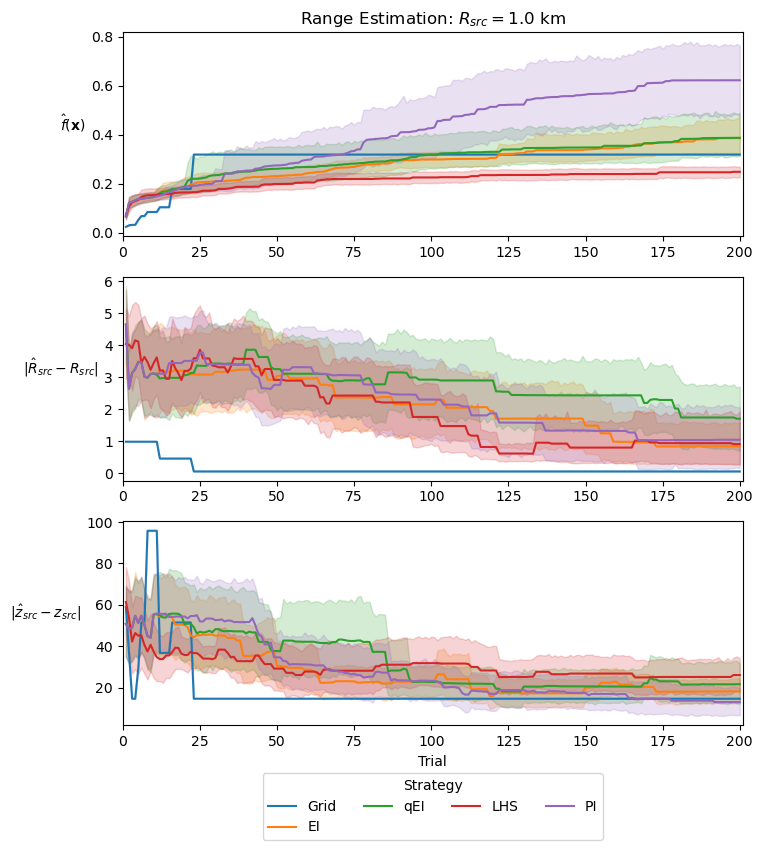

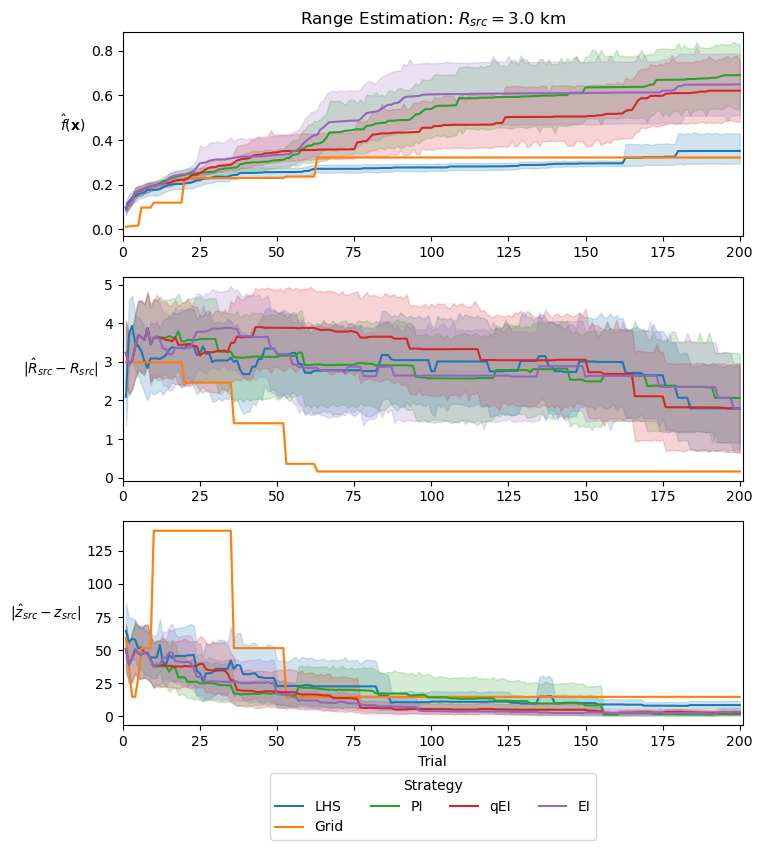

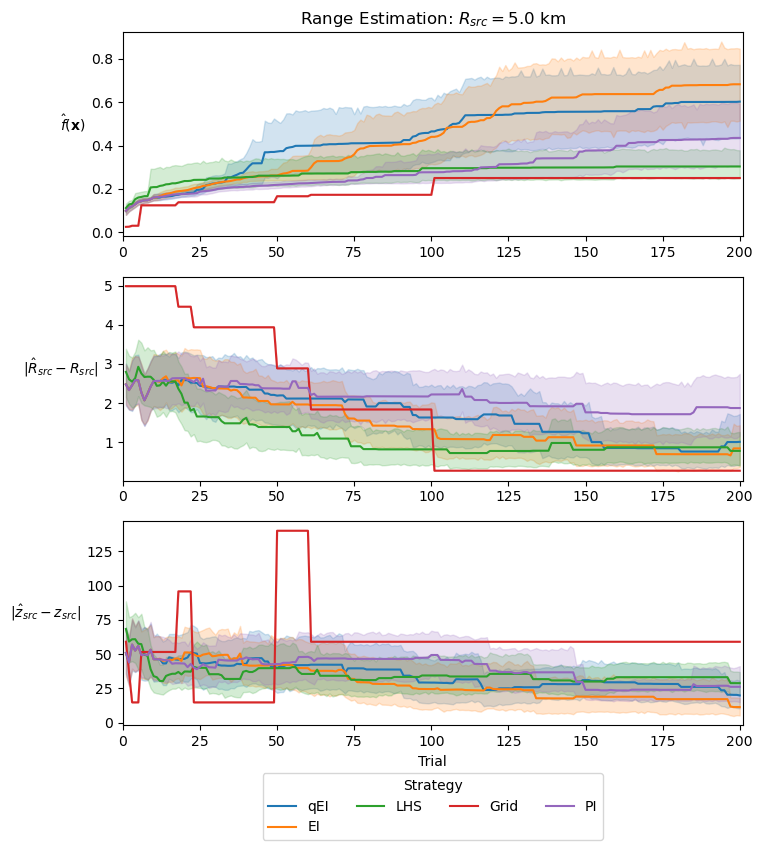

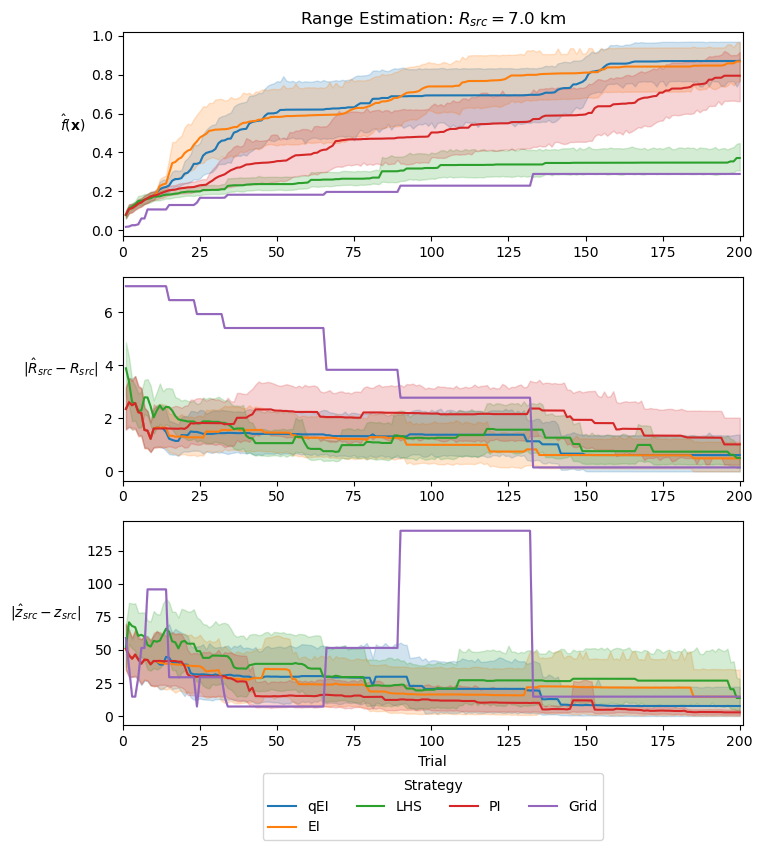

In [14]:
for r in sorted(df["range"].unique()):
    selection = df["range"] == r

    fig, axs = plt.subplots(figsize=(8, 9), nrows=3)

    ax = axs[0]
    sns.lineplot(
        data=df[selection],
        x="trial_index",
        y="best_values",
        hue="strategy",
        ax=ax,
        legend=None,
    )
    ax.set_xlim([0, 201])
    ax.set_xlabel(None)
    ax.set_ylabel("$\hat{f}(\mathbf{x})$", rotation=0, ha="right")
    ax.set_title(f"Range Estimation: $R_{{src}} = {r}$ km")

    ax = axs[1]
    sns.lineplot(
        data=df[selection],
        x="trial_index",
        y="best_range_error",
        hue="strategy",
        ax=ax,
        legend=None,
    )
    ax.set_xlim([0, 201])
    ax.set_xlabel(None)
    ax.set_ylabel("$\\vert \hat{R}_{src}- R_{src} \\vert$", rotation=0, ha="right")
    ax.set_title(None)

    ax = axs[2]
    sns.lineplot(
        data=df[selection], x="trial_index", y="best_depth_error", hue="strategy", ax=ax
    )
    ax.set_xlim([0, 201])
    sns.move_legend(
        ax, "upper center", bbox_to_anchor=(0.5, -0.2), ncol=4, title="Strategy"
    )
    ax.set_xlabel("Trial")
    ax.set_ylabel("$\\vert \hat{z}_{src}- z_{src} \\vert$", rotation=0, ha="right")
    ax.set_title(None)

    fig.savefig(
        FIGURE_PATH.parents[1] / "Figures" / f"perf_hist_ls_{r}km_mf2.png", **SAVEFIG_KWARGS
    )
    plt.show()

## 3. Experimental Data: SWellEx-96

Load experimental data results. Multi-frequency MFP at high resolution (500 range bins, 100 depth bins) provides the baseline against which to compare optimization strategies.

In [2]:
no_data = [
    list(range(73, 85)),
    list(range(95, 103)),
    list(range(187, 199)),
    list(range(287, 294)),
    list(range(302, 309))
]

SKIP_T = (
    [49, 72, 94, 186, 286, 301]
    + no_data[0]
    + no_data[1]
    + no_data[2]
    + no_data[3]
    + no_data[4]
)

XLIM = [0, 350]
NO_DATA_KW = {
    "color": "black",
    "alpha": 0.25,
    "linewidth": 0,
    "label": None
}

# Load high-res MFP
timesteps, ranges, depths = collate.load_mfp_results(AMBSURF_PATH)

# GPS Range
gps_fname = ROOT / "Data" / "SWELLEX96" / "VLA" / "selected" / "gps_range.csv"
df_gps = pd.read_csv(gps_fname, index_col=0)

#### Show high-resolution MFP

In [24]:
vname = AMBSURF_PATH / "figures" / "ImageSequence.mp4"
Video(vname, embed=True)

### Localization with constrained depth

Array tilt and a sloped bottom cause mismatch between the true and modeled environments, leading to source depth shifting deeper as the source approaches CPA. To permit the optimization strategies to obtain more accurate range estimations, source depth is allowed to be searched within a narrow range rather than remaining fixed.

In [5]:
serial = "serial_constrained_50-75"
fname = ROOT / "Data" / "localization" / "experimental" / serial / "results" / "collated.csv"
df = pd.read_csv(fname, index_col=0)
df

,optimization,mode,serial,Time Step,strategy,seed,bartlett,trial_index,arm_name,rec_r,src_z,trial_status,generation_method
0,localization,experimental,serial_constrained_50-75,32,PI,292288111.0,0.387969,163.0,162_0,7.595025,53.374863,COMPLETED,BoTorch
1,localization,experimental,serial_constrained_50-75,32,EI,292288111.0,0.387964,83.0,82_0,7.595210,53.395019,COMPLETED,BoTorch
2,localization,experimental,serial_constrained_50-75,32,qEI,292288111.0,0.387969,69.0,68_0,7.595070,53.372913,COMPLETED,BoTorch
3,localization,experimental,serial_constrained_50-75,32,LHS,292288111.0,0.346465,24.0,23_0,7.555657,54.306255,COMPLETED,Manual
4,localization,experimental,serial_constrained_50-75,32,Rand,292288111.0,0.349084,73.0,72_0,7.589048,56.152953,COMPLETED,Manual
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2676,NaN,NaN,NaN,345,High-res MFP,NaN,NaN,NaN,NaN,1.511503,69.343434,NaN,NaN
2677,NaN,NaN,NaN,346,High-res MFP,NaN,NaN,NaN,NaN,1.531523,69.343434,NaN,NaN
2678,NaN,NaN,NaN,347,High-res MFP,NaN,NaN,NaN,NaN,1.551543,67.333333,NaN,NaN
2679,NaN,NaN,NaN,348,High-res MFP,NaN,NaN,NaN,NaN,1.571563,67.333333,NaN,NaN


#### Range estimation

,Strategy,MAE
8,High-res MFP,4.843255e-17
2,qEI,4.707801e-01
1,EI,4.824950e-01
3,LHS,6.547072e-01
4,Rand,7.029640e-01
5,Sobol,7.307133e-01
7,SBL,7.837582e-01
6,Grid,9.037682e-01
0,PI,9.471277e-01


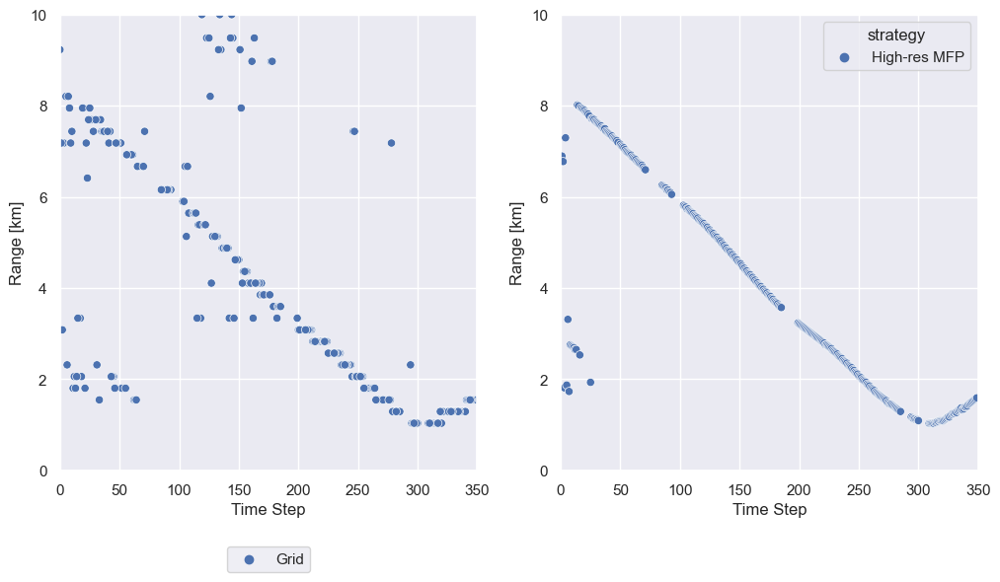

In [6]:
sns.set_theme(style="darkgrid")

zvec = np.linspace(1, 200, 100)
rvec = np.linspace(10e-3, 10, 500)
zind = np.argmin(np.abs(zvec - 60))

fig, axs = plt.subplots(ncols=2, figsize=(12, 6))
ax = axs[0]
sns.scatterplot(
    data=df[df["strategy"] == "Grid"], x="Time Step", y="rec_r", hue="strategy", ax=ax
)
# sns.scatterplot(data=df, x="Time Step", y="rec_r", hue="strategy", ax=ax)
ax.set_ylabel("Range [km]")
ax.legend(loc="upper center", bbox_to_anchor=(0.5, -0.15), ncols=4)
ax.set_xlim([0, 350])
ax.set_ylim([0, 10])

ax = axs[1]
sns.scatterplot(
    data=df[df["strategy"] == "High-res MFP"], x="Time Step", y="rec_r", hue="strategy", ax=ax
)
ax.set_xlabel("Time Step")
ax.set_ylabel("Range [km]")
ax.set_xlim([0, 350])
ax.set_ylim([0, 10])

errors = []
for strategy in df["strategy"].unique():
    error, _ = figures.get_error(df[df["strategy"] == strategy], "rec_r", timesteps, ranges)
    MAE = np.mean(np.abs(error))
    errors.append({"Strategy": strategy, "MAE": MAE})

error_df = pd.DataFrame.from_dict(errors).sort_values("MAE")
error_df

#### Depth estimation

,Strategy,MAE
8,High-res MFP,2.384372e-16
2,qEI,2.569960e+00
1,EI,2.777438e+00
0,PI,3.536306e+00
5,Sobol,4.100809e+00
3,LHS,4.433982e+00
6,Grid,5.418099e+00
4,Rand,5.806024e+00
7,SBL,7.247839e+00


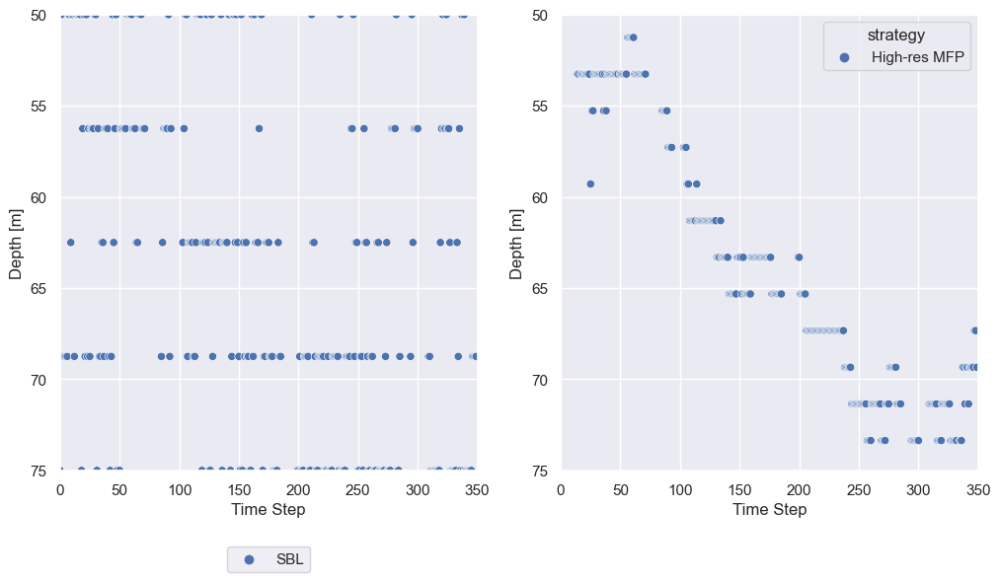

In [7]:
sns.set_theme(style="darkgrid")
# import matplotlib.pyplot as plt

zvec = np.linspace(1, 200, 100)
rvec = np.linspace(10e-3, 10, 500)
# zind = np.argmin(np.abs(zvec - 60))

fig, axs = plt.subplots(ncols=2, figsize=(12, 6))
ax = axs[0]
sns.scatterplot(
    data=df[df["strategy"] == "SBL"], x="Time Step", y="src_z", hue="strategy", ax=ax
)
# sns.scatterplot(data=df, x="Time Step", y="src_z", hue="strategy", ax=ax)
ax.set_ylabel("Depth [m]")
ax.legend(loc="upper center", bbox_to_anchor=(0.5, -0.15), ncols=4)
ax.set_xlim([0, 350])
ax.set_ylim([75, 50])

ax = axs[1]
sns.scatterplot(
    data=df[df["strategy"] == "High-res MFP"], x="Time Step", y="src_z", hue="strategy", ax=ax
)
ax.set_xlabel("Time Step")
ax.set_ylabel("Depth [m]")
ax.set_xlim([0, 350])
ax.set_ylim([75, 50])

errors = []
for strategy in df["strategy"].unique():
    error, _ = figures.get_error(df[df["strategy"] == strategy], "src_z", timesteps, depths)
    MAE = np.mean(np.abs(error))
    errors.append({"Strategy": strategy, "MAE": MAE})

error_df = pd.DataFrame.from_dict(errors).sort_values("MAE")
error_df

#### All results

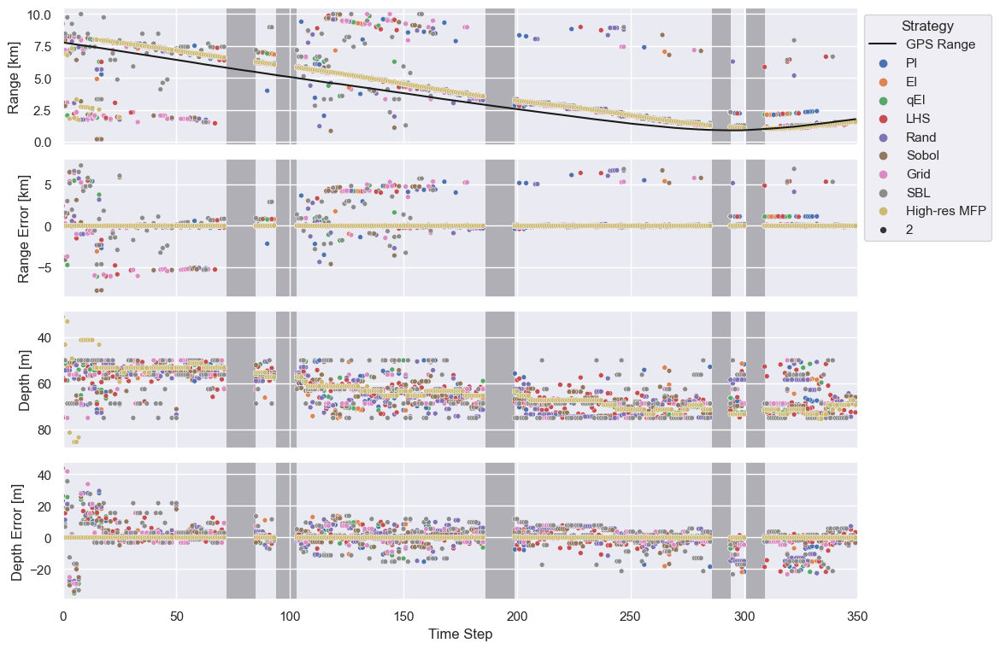

In [16]:
fig, axs = plt.subplots(figsize=(12, 9), nrows=4, gridspec_kw={"hspace": 0.1})

ax = axs[0]
sns.lineplot(data=df_gps, x=df_gps.index, y="Range [km]", color="k", label="GPS Range", ax=ax)
sns.scatterplot(data=df, x="Time Step", y="rec_r", hue="strategy", size=2, ax=ax)
[ax.axvspan(l[0] - 1, l[-1] + 1, zorder=-10, **NO_DATA_KW) for l in no_data]
ax.set_xticklabels([])
ax.set_xlim(XLIM)
ax.set_xlabel(None)
ax.set_ylabel("Range [km]")
sns.move_legend(
    ax, "upper left", bbox_to_anchor=(1.0, 1.0), title="Strategy"
)

ax = axs[1]
for strategy in df["strategy"].unique().tolist():
    error, est_timesteps = figures.get_error(df[df["strategy"] == strategy], "rec_r", timesteps, ranges)
    sns.scatterplot(x=est_timesteps, y=error, size=2, ax=ax, legend=None)
[ax.axvspan(l[0] - 1, l[-1] + 1, zorder=-10, **NO_DATA_KW) for l in no_data]
ax.set_xticklabels([])
ax.set_xlim(XLIM)
ax.set_xlabel(None)
ax.set_ylabel("Range Error [km]")

ax = axs[2]
sns.scatterplot(data=df, x="Time Step", y="src_z", hue="strategy", size=2, ax=ax, legend=None)
ax.invert_yaxis()
[ax.axvspan(l[0] - 1, l[-1] + 1, zorder=-10, **NO_DATA_KW) for l in no_data]
ax.set_xticklabels([])
ax.set_xlim(XLIM)
ax.set_xlabel(None)
ax.set_ylabel("Depth [m]")

ax = axs[3]
for strategy in df["strategy"].unique().tolist():
    error, est_timesteps = figures.get_error(df[df["strategy"] == strategy], "src_z", timesteps, depths)
    sns.scatterplot(x=est_timesteps, y=error, size=2, ax=ax, legend=None)
[ax.axvspan(l[0] - 1, l[-1] + 1, zorder=-10, **NO_DATA_KW) for l in no_data]
ax.set_xlim(XLIM)
ax.set_xlabel("Time Step")
ax.set_ylabel("Depth Error [m]")

plt.show()

#### Dashboard for paper

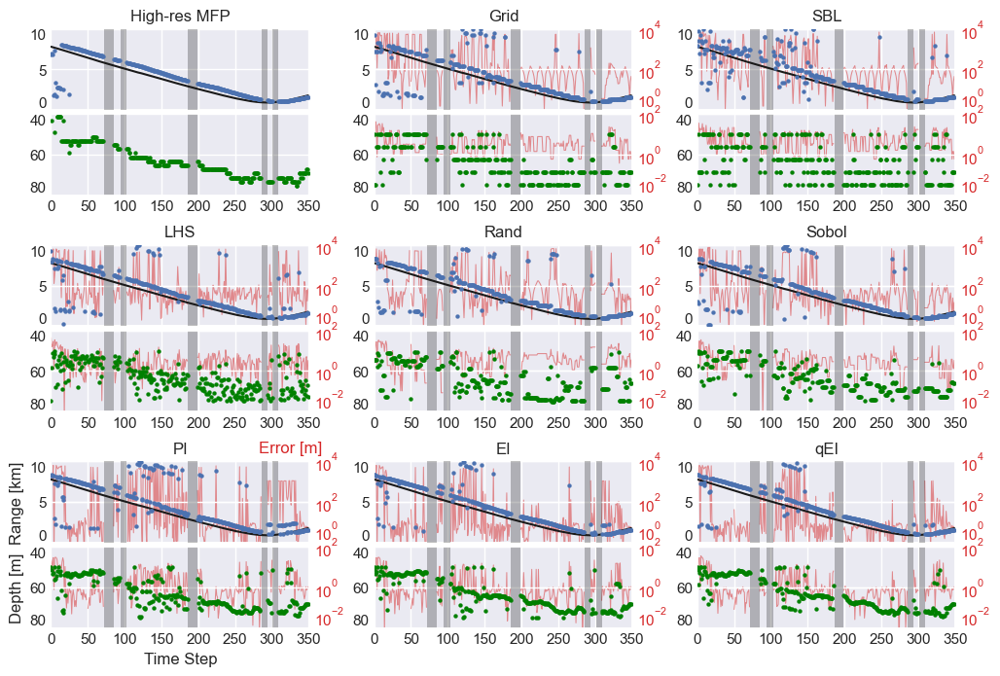

In [17]:
fig = figures.plot_experimental_results(df, df_gps, timesteps, ranges, depths)
plt.show()

#### Best evaluations

             strategy
trial_index  EI          118.986577
             Grid         80.580537
             LHS         105.912752
             PI          152.717172
             Rand        106.973154
             Sobol       113.926174
             qEI         125.275168
dtype: float64


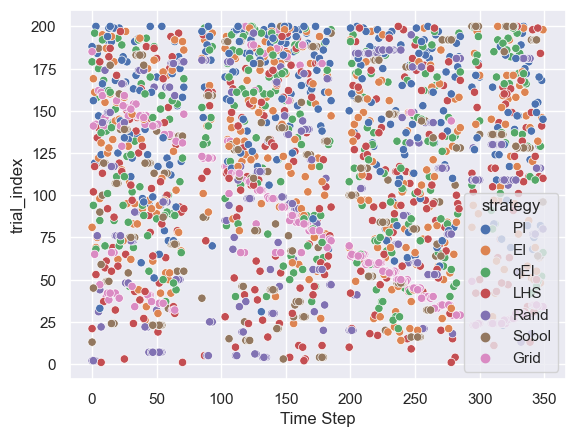

In [18]:
selection = ~df["strategy"].isin(["High-res MFP", "SBL"])
df2 = df[selection]
df3 = pd.pivot(df2, index="Time Step", columns=["strategy"], values=["trial_index"])
print(df3.mean())

sns.scatterplot(data=df2, x="Time Step", y="trial_index", hue="strategy")
plt.show()

### Full localization

Load experimental data results.

In [3]:
serial = "serial_full_depth"
fname = ROOT / "Data" / "localization" / "experimental" / serial / "results" / "collated.csv"
df = pd.read_csv(fname, index_col=0)
df

,optimization,mode,serial,Time Step,strategy,seed,bartlett,trial_index,arm_name,rec_r,src_z,trial_status,generation_method
0,localization,experimental,serial_full_depth,275,Rand,292288111.0,0.429903,159.0,158_0,1.532319,76.006316,COMPLETED,Manual
1,localization,experimental,serial_full_depth,275,Sobol,292288111.0,0.479274,577.0,576_0,1.472468,74.689284,COMPLETED,Manual
2,localization,experimental,serial_full_depth,275,EI,292288111.0,0.285789,757.0,756_0,4.566733,198.115697,COMPLETED,BoTorch
3,localization,experimental,serial_full_depth,275,PI,292288111.0,0.695332,687.0,686_0,1.484531,71.066647,COMPLETED,BoTorch
4,localization,experimental,serial_full_depth,275,qEI,292288111.0,0.479353,780.0,779_0,1.432904,67.878639,COMPLETED,BoTorch
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2677,NaN,NaN,NaN,345,High-res MFP,NaN,NaN,NaN,NaN,1.511503,69.343434,NaN,NaN
2678,NaN,NaN,NaN,346,High-res MFP,NaN,NaN,NaN,NaN,1.531523,69.343434,NaN,NaN
2679,NaN,NaN,NaN,347,High-res MFP,NaN,NaN,NaN,NaN,1.551543,67.333333,NaN,NaN
2680,NaN,NaN,NaN,348,High-res MFP,NaN,NaN,NaN,NaN,1.571563,67.333333,NaN,NaN


#### Range estimation

,Strategy,MAE
8,High-res MFP,4.843255e-17
3,PI,4.362948e-01
4,qEI,4.968614e-01
2,EI,5.554395e-01
1,Sobol,6.793398e-01
6,Grid,7.012923e-01
7,SBL,7.837582e-01
5,LHS,9.107667e-01
0,Rand,9.331787e-01


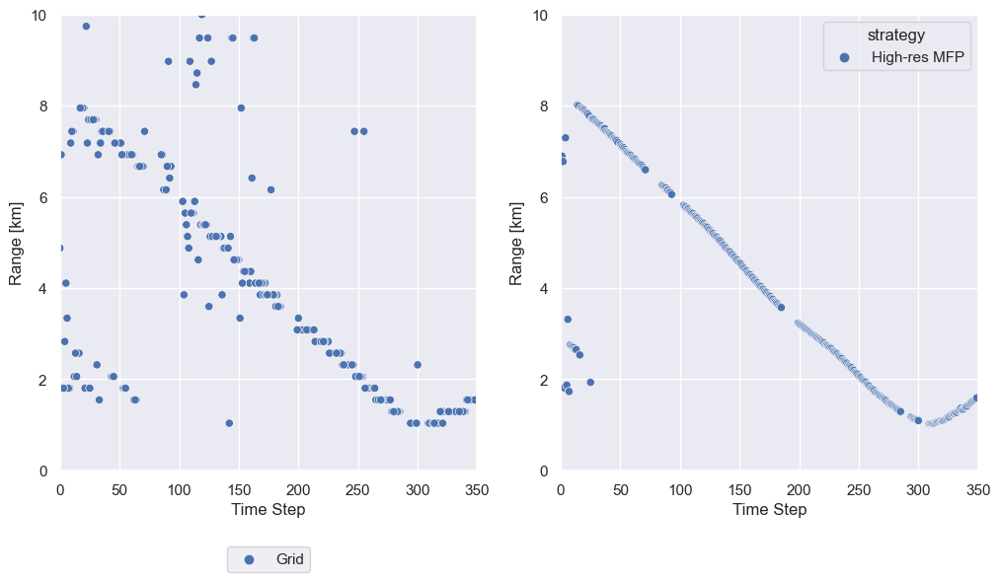

In [5]:
sns.set_theme(style="darkgrid")

zvec = np.linspace(1, 200, 100)
rvec = np.linspace(10e-3, 10, 500)
zind = np.argmin(np.abs(zvec - 60))

fig, axs = plt.subplots(ncols=2, figsize=(12, 6))
ax = axs[0]
sns.scatterplot(
    data=df[df["strategy"] == "Grid"], x="Time Step", y="rec_r", hue="strategy", ax=ax
)
# sns.scatterplot(data=df, x="Time Step", y="rec_r", hue="strategy", ax=ax)
ax.set_ylabel("Range [km]")
ax.legend(loc="upper center", bbox_to_anchor=(0.5, -0.15), ncols=4)
ax.set_xlim([0, 350])
ax.set_ylim([0, 10])

ax = axs[1]
sns.scatterplot(
    data=df[df["strategy"] == "High-res MFP"], x="Time Step", y="rec_r", hue="strategy", ax=ax
)
ax.set_xlabel("Time Step")
ax.set_ylabel("Range [km]")
ax.set_xlim([0, 350])
ax.set_ylim([0, 10])

errors = []
for strategy in df["strategy"].unique():
    error, _ = figures.get_error(df[df["strategy"] == strategy], "rec_r", timesteps, ranges)
    MAE = np.mean(np.abs(error))
    errors.append({"Strategy": strategy, "MAE": MAE})

error_df = pd.DataFrame.from_dict(errors).sort_values("MAE")
error_df

#### Depth estimation

,Strategy,MAE
8,High-res MFP,2.384372e-16
3,PI,5.755676e+00
4,qEI,6.026245e+00
7,SBL,7.247839e+00
2,EI,8.923700e+00
6,Grid,1.010127e+01
1,Sobol,1.181433e+01
5,LHS,1.184384e+01
0,Rand,1.269748e+01


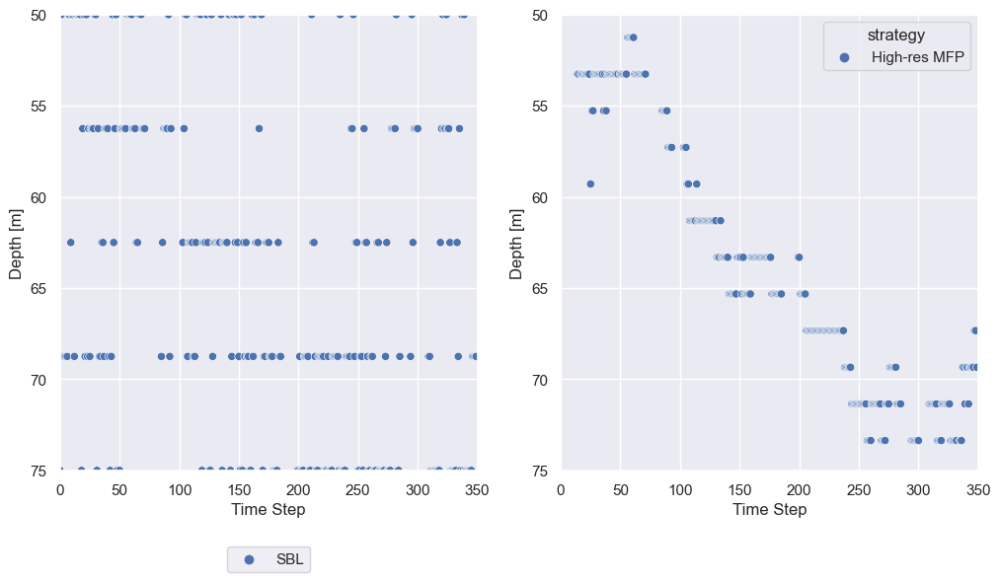

In [7]:
sns.set_theme(style="darkgrid")
# import matplotlib.pyplot as plt

zvec = np.linspace(1, 200, 100)
rvec = np.linspace(10e-3, 10, 500)
# zind = np.argmin(np.abs(zvec - 60))

fig, axs = plt.subplots(ncols=2, figsize=(12, 6))
ax = axs[0]
sns.scatterplot(
    data=df[df["strategy"] == "SBL"], x="Time Step", y="src_z", hue="strategy", ax=ax
)
# sns.scatterplot(data=df, x="Time Step", y="src_z", hue="strategy", ax=ax)
ax.set_ylabel("Depth [m]")
ax.legend(loc="upper center", bbox_to_anchor=(0.5, -0.15), ncols=4)
ax.set_xlim([0, 350])
ax.set_ylim([75, 50])

ax = axs[1]
sns.scatterplot(
    data=df[df["strategy"] == "High-res MFP"], x="Time Step", y="src_z", hue="strategy", ax=ax
)
ax.set_xlabel("Time Step")
ax.set_ylabel("Depth [m]")
ax.set_xlim([0, 350])
ax.set_ylim([75, 50])

errors = []
for strategy in df["strategy"].unique():
    error, _ = figures.get_error(df[df["strategy"] == strategy], "src_z", timesteps, depths)
    MAE = np.mean(np.abs(error))
    errors.append({"Strategy": strategy, "MAE": MAE})

error_df = pd.DataFrame.from_dict(errors).sort_values("MAE")
error_df

#### All results

In [ ]:
fig, axs = plt.subplots(figsize=(12, 9), nrows=4, gridspec_kw={"hspace": 0.1})

ax = axs[0]
sns.lineplot(data=df_gps, x=df_gps.index, y="Range [km]", color="k", label="GPS Range", ax=ax)
sns.scatterplot(data=df, x="Time Step", y="rec_r", hue="strategy", size=2, ax=ax)
[ax.axvspan(l[0] - 1, l[-1] + 1, zorder=-10, **NO_DATA_KW) for l in no_data]
ax.set_xticklabels([])
ax.set_xlim(XLIM)
ax.set_xlabel(None)
ax.set_ylabel("Range [km]")
sns.move_legend(
    ax, "upper left", bbox_to_anchor=(1.0, 1.0), title="Strategy"
)

ax = axs[1]
for strategy in df["strategy"].unique().tolist():
    error, est_timesteps = figures.get_error(df[df["strategy"] == strategy], "rec_r", timesteps, ranges)
    sns.scatterplot(x=est_timesteps, y=error, size=2, ax=ax, legend=None)
[ax.axvspan(l[0] - 1, l[-1] + 1, zorder=-10, **NO_DATA_KW) for l in no_data]
ax.set_xticklabels([])
ax.set_xlim(XLIM)
ax.set_xlabel(None)
ax.set_ylabel("Range Error [km]")

ax = axs[2]
sns.scatterplot(data=df, x="Time Step", y="src_z", hue="strategy", size=2, ax=ax, legend=None)
ax.invert_yaxis()
[ax.axvspan(l[0] - 1, l[-1] + 1, zorder=-10, **NO_DATA_KW) for l in no_data]
ax.set_xticklabels([])
ax.set_xlim(XLIM)
ax.set_xlabel(None)
ax.set_ylabel("Depth [m]")

ax = axs[3]
for strategy in df["strategy"].unique().tolist():
    error, est_timesteps = figures.get_error(df[df["strategy"] == strategy], "src_z", timesteps, depths)
    sns.scatterplot(x=est_timesteps, y=error, size=2, ax=ax, legend=None)
[ax.axvspan(l[0] - 1, l[-1] + 1, zorder=-10, **NO_DATA_KW) for l in no_data]
ax.set_xlim(XLIM)
ax.set_xlabel("Time Step")
ax.set_ylabel("Depth Error [m]")

plt.show()

#### Dashboard for paper

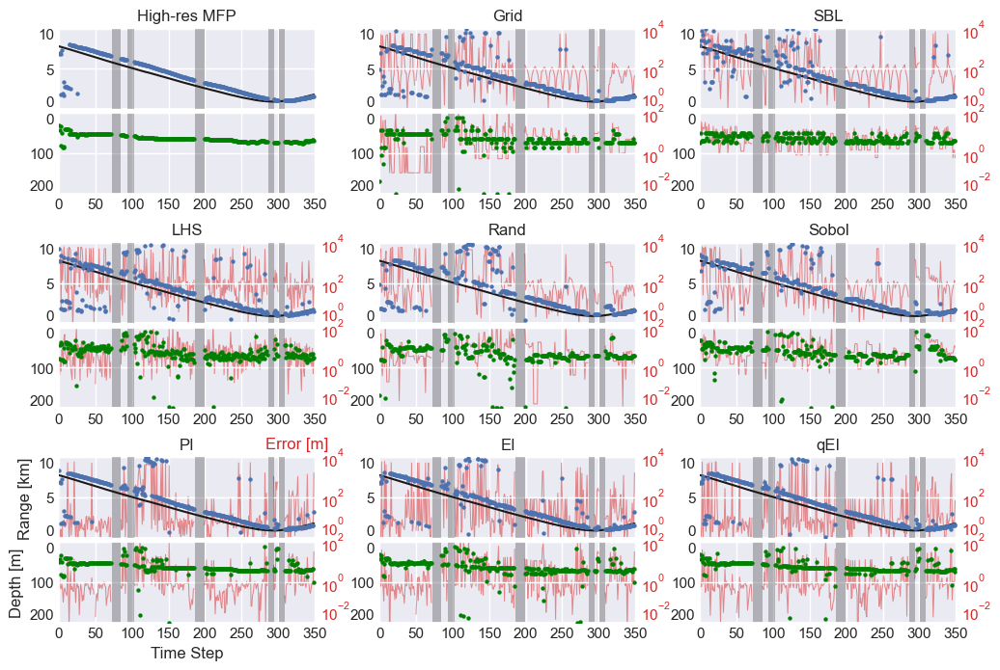

In [4]:
fig = figures.plot_experimental_results(df, df_gps, timesteps, ranges, depths, ylim_z=[200, 0], yticks_z=[0, 100, 200])
plt.show()

#### Best evaluations

In [ ]:
selection = ~df["strategy"].isin(["High-res MFP", "SBL"])
df2 = df[selection]
df3 = pd.pivot(df2, index="Time Step", columns=["strategy"], values=["trial_index"])
print(df3.mean())

sns.scatterplot(data=df2, x="Time Step", y="trial_index", hue="strategy")
plt.show()

## Supporting Illustrations

(0.0, 0.42)

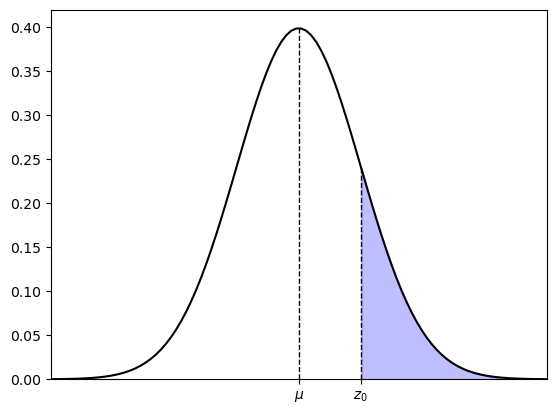

In [74]:
from scipy.stats import norm

z0 = 1
mu = 0
std = 1

x = np.linspace(mu - 4, mu + 4, 100)
y = norm.pdf(x, mu, std)
y_mu = norm.pdf(0, mu, std)
y_z0 = norm.pdf(z0, mu, std)

fig = plt.figure()
ax = plt.gca()
ax.plot(x, y, color="black")
ax.fill_between(x, y, where=(x > z0) & (x < 10), color='blue', alpha=0.25)
ax.vlines(x=0, ymin=0, ymax=y_mu, color='black', linestyle='--', linewidth=1)
ax.vlines(x=z0, ymin=0, ymax=y_z0, color='black', linestyle='--', linewidth=1)

ax.set_xlim([-4, 4])
ax.set_xticks([0, z0])
ax.set_xticklabels(["$\\mu$", "$z_0$"])

ax.set_ylim([0, 0.42])
# ax.set_xlabel("$f$")
# ax.set_ylabel("$p(f)$")

## Inspect individual trial

## High-resolution MFP using OAO

In [256]:
# results = "/Users/williamjenkins/Research/Projects/BOGP/Data/localization/experimental/serial_test_surf/timestep=250/grid/seed_0292288111/results.json"
# client = AxClient.load_from_json_file(results)

df = pd.read_csv("/Users/williamjenkins/Research/Projects/BOGP/Data/localization/experimental/serial_test_surf4/results/aggregated_results.csv", index_col=0)
df["scenario"] = df["scenario"].apply(lambda x: ast.literal_eval(x)).apply(lambda x: list(x.values())[0])
df = df.rename(columns={"scenario": "Time Step"})

rvec = np.unique(df["rec_r"].values)
zvec = np.unique(df["src_z"].values)
M = len(zvec)
N = len(rvec)

surf = np.reshape(df["bartlett"].values, (M, N)).T
src_z_ind, src_r_ind = np.unravel_index(np.argmax(surf), (len(zvec), len(rvec)))
src_z_ind, src_r_ind

(13, 10)

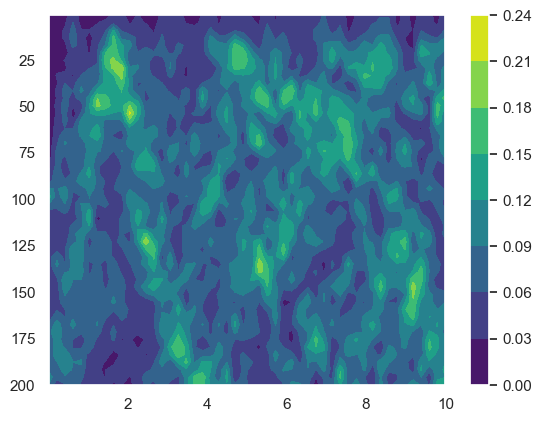

In [257]:
from mpl_toolkits.mplot3d.axes3d import Axes3D

r = np.reshape(df["rec_r"].values, (N, M)).T
z = np.reshape(df["src_z"].values, (N, M)).T

fig = plt.figure()
# ax = fig.add_subplot(projection="3d")
# ax.plot_surface(X=r, Y=z, Z=surf)
plt.contourf(r, z, surf, cmap="viridis")
plt.gca().invert_yaxis()
plt.colorbar()

Text(0, 0.5, 'Depth [m]')

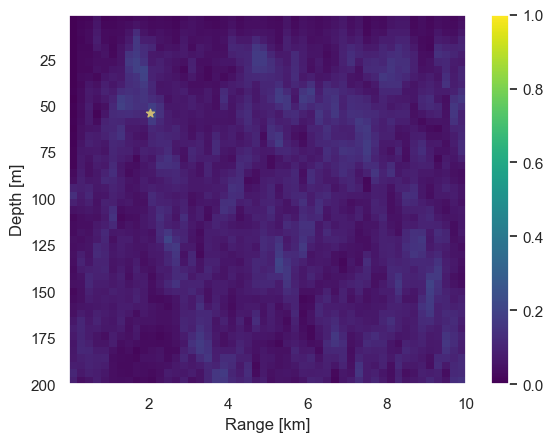

In [258]:
plt.imshow(surf, aspect="auto", origin="lower", cmap="viridis", interpolation="none", vmin=0, vmax=1, extent=[min(rvec), max(rvec), min(zvec), max(zvec)])
plt.colorbar()
plt.scatter(rvec[src_r_ind], zvec[src_z_ind], c="y", marker="*")
plt.gca().invert_yaxis()
plt.grid()
plt.xlabel("Range [km]")
plt.ylabel("Depth [m]")

[INFO 02-27 10:06:18] ax.service.ax_client: Starting optimization with verbose logging. To disable logging, set the `verbose_logging` argument to `False`. Note that float values in the logs are rounded to 6 decimal points.


     bartlett  trial_index arm_name     rec_r      src_z trial_status  \
0    0.240164            0      0_0  2.189045  71.054775    COMPLETED   
1    0.079579            1      1_0  7.971145  68.008444    COMPLETED   
2    0.089139            2      2_0  0.380121  74.284524    COMPLETED   
3    0.071615            3      3_0  6.511614  59.520138    COMPLETED   
4    0.035542            4      4_0  8.765704  60.985159    COMPLETED   
..        ...          ...      ...       ...        ...          ...   
195  0.037170          195    195_0  8.431949  54.627732    COMPLETED   
196  0.027486          196    196_0  2.681569  69.381832    COMPLETED   
197  0.095360          197    197_0  4.621425  54.413110    COMPLETED   
198  0.058776          198    198_0  3.316346  70.574622    COMPLETED   
199  0.091480          199    199_0  5.982439  62.326660    COMPLETED   

    generation_method  
0               Sobol  
1               Sobol  
2               Sobol  
3               Sobol  
4  

[INFO 02-27 10:06:23] ax.service.ax_client: Retrieving contour plot with parameter 'rec_r' on X-axis and 'src_z' on Y-axis, for metric 'bartlett'. Remaining parameters are affixed to the middle of their range.


[INFO 02-27 10:06:24] ax.service.ax_client: Retrieving contour plot with parameter 'rec_r' on X-axis and 'src_z' on Y-axis, for metric 'bartlett'. Remaining parameters are affixed to the middle of their range.


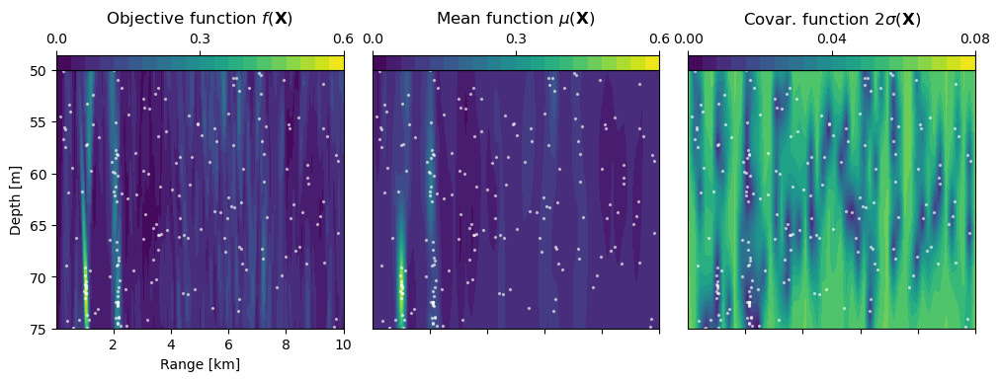

In [161]:
timestep = 310
strategy = "greedy_batch_qei"

results = f"/Users/williamjenkins/Research/Projects/BOGP/Data/localization/experimental/serial_constrained_50-75/timestep={timestep}/{strategy}/seed_0292288111/results.json"
client = AxClient.load_from_json_file(results)
print(client.get_trials_data_frame())
print(client.get_best_parameters())
render(client.get_optimization_trace())
render(client.get_contour_plot())

data = client.get_contour_plot()
rvec = data.data["data"][0]["x"]
zvec = data.data["data"][0]["y"]
mean = data.data["data"][0]
se = data.data["data"][1]
x = data.data["data"][3]["x"]
y = data.data["data"][3]["y"]

rvec_f = np.linspace(0.01, 10, 500)
zvec_f = np.linspace(1, 200, 100)
# zinds = np.where((zvec_f >= 50) & (zvec_f <= 75))
f = np.load(AMBSURF_PATH / f"ambsurf_mf_t={timestep}.npy")
# f = f[zinds]

CBAR_KW = {
    "location": "top",
    "pad": 0
}
CONTOUR_KW = {
    "origin": "lower",
    "extent": [0, 10, 50, 75],
    # "levels": 20
    # "vmin": 0,
    # "vmax": 0.8
}
SCATTER_KW = {
    "color": "white",
    "alpha": 0.5,
    "s": 2
}
TITLE_KW = {
    "y": 1.15
}
NLEVELS = 21

fig, axs = plt.subplots(ncols=3, figsize=(12, 4), gridspec_kw={"wspace": 0.1})

# plt.imshow(test["z"], aspect="auto", origin="lower")
ax = axs[0]
vmin = 0
vmax = 0.6
vmid = vmax / 2
ax.set_title("Objective function $f(\mathbf{X})$", **TITLE_KW)
im = ax.contourf(rvec_f, zvec_f, f, levels=np.linspace(vmin, vmax, NLEVELS), **CONTOUR_KW)
ax.scatter(x, y, **SCATTER_KW)
ax.invert_yaxis()
ax.set_xlabel("Range [km]")
ax.set_ylim([75, 50])
ax.set_ylabel("Depth [m]")
cbar = fig.colorbar(im, ax=ax, ticks=[vmin, vmid, vmax], **CBAR_KW)

ax = axs[1]
ax.set_title("Mean function $\mu(\mathbf{X})$", **TITLE_KW)
im = ax.contourf(rvec, zvec, mean["z"], levels=np.linspace(vmin, vmax, NLEVELS), **CONTOUR_KW)
ax.scatter(x, y, **SCATTER_KW)
ax.invert_yaxis()
ax.set_xticklabels([])
ax.set_yticks([])
ax.set_yticklabels([])
cbar = plt.colorbar(im, ax=ax, ticks=[vmin, vmid, vmax], **CBAR_KW)

ax = axs[2]
vmin = 0
vmax = 0.08
vmid = vmax / 2
ax.set_title("Covar. function $2\sigma(\mathbf{X})$", **TITLE_KW)
im = ax.contourf(rvec, zvec, se["z"], levels=np.linspace(vmin, vmax, NLEVELS), **CONTOUR_KW)
ax.scatter(x, y, **SCATTER_KW)
ax.invert_yaxis()
ax.set_xticklabels([])
ax.set_yticks([])
ax.set_yticklabels([])
cbar = plt.colorbar(im, ax=ax, ticks=[vmin, vmid, vmax], **CBAR_KW)

plt.show()



In [162]:
best, _, _  = client.get_best_parameters()

({'rec_r': 1.0384611392016998, 'src_z': 71.5573144067448},
 ({'bartlett': 0.5671151783932337},
  {'bartlett': {'bartlett': 1.4385427290671282e-08}}))

In [163]:
timestep = 310
strategy = "greedy_batch_qei"

results = f"/Users/williamjenkins/Research/Projects/BOGP/Data/localization/experimental/serial_full_depth/timestep={timestep}/{strategy}/seed_0292288111/results.json"
client = AxClient.load_from_json_file(results)
client.get_best_parameters()
# print(client.get_trials_data_frame())
# print(client.get_best_parameters())
# render(client.get_optimization_trace())
# render(client.get_contour_plot())

# data = client.get_contour_plot()
# rvec = data.data["data"][0]["x"]
# zvec = data.data["data"][0]["y"]
# mean = data.data["data"][0]
# se = data.data["data"][1]
# x = data.data["data"][3]["x"]
# y = data.data["data"][3]["y"]

# rvec_f = np.linspace(0.01, 10, 500)
# zvec_f = np.linspace(1, 200, 100)
# # zinds = np.where((zvec_f >= 50) & (zvec_f <= 75))
# f = np.load(AMBSURF_PATH / f"ambsurf_mf_t={timestep}.npy")
# # f = f[zinds]

# CBAR_KW = {
#     "location": "top",
#     "pad": 0
# }
# CONTOUR_KW = {
#     "origin": "lower",
#     "extent": [0, 10, 0, 200],
#     # "levels": 20
#     # "vmin": 0,
#     # "vmax": 0.8
# }
# SCATTER_KW = {
#     "color": "white",
#     "alpha": 0.25,
#     "s": 1
# }
# TITLE_KW = {
#     "y": 1.15
# }
# NLEVELS = 21

# fig, axs = plt.subplots(ncols=3, figsize=(12, 4), gridspec_kw={"wspace": 0.1})

# # plt.imshow(test["z"], aspect="auto", origin="lower")
# ax = axs[0]
# vmin = 0
# vmax = 0.6
# vmid = vmax / 2
# ax.set_title("Objective function $f(\mathbf{X})$", **TITLE_KW)
# im = ax.contourf(rvec_f, zvec_f, f, levels=np.linspace(vmin, vmax, NLEVELS), **CONTOUR_KW)
# ax.scatter(x, y, **SCATTER_KW)
# ax.invert_yaxis()
# ax.set_xlabel("Range [km]")
# ax.set_ylabel("Depth [m]")
# cbar = fig.colorbar(im, ax=ax, ticks=[vmin, vmid, vmax], **CBAR_KW)

# ax = axs[1]
# ax.set_title("Mean function $\mu(\mathbf{X})$", **TITLE_KW)
# im = ax.contourf(rvec, zvec, mean["z"], levels=np.linspace(vmin, vmax, NLEVELS), **CONTOUR_KW)
# ax.scatter(x, y, **SCATTER_KW)
# ax.invert_yaxis()
# ax.set_xticklabels([])
# ax.set_yticks([])
# ax.set_yticklabels([])
# cbar = plt.colorbar(im, ax=ax, ticks=[vmin, vmid, vmax], **CBAR_KW)

# ax = axs[2]
# vmin = 0
# vmax = 0.06
# vmid = vmax / 2
# ax.set_title("Covar. function $2\sigma(\mathbf{X})$", **TITLE_KW)
# im = ax.contourf(rvec, zvec, se["z"], levels=np.linspace(vmin, vmax, NLEVELS), **CONTOUR_KW)
# ax.scatter(x, y, **SCATTER_KW)
# ax.invert_yaxis()
# ax.set_xticklabels([])
# ax.set_yticks([])
# ax.set_yticklabels([])
# cbar = plt.colorbar(im, ax=ax, ticks=[vmin, vmid, vmax], **CBAR_KW)

# plt.show()



[INFO 02-27 10:06:53] ax.service.ax_client: Starting optimization with verbose logging. To disable logging, set the `verbose_logging` argument to `False`. Note that float values in the logs are rounded to 6 decimal points.


({'rec_r': 1.0384364825328516, 'src_z': 71.56110641619802},
 ({'bartlett': 0.5666166726278183},
  {'bartlett': {'bartlett': 4.933050293084756e-09}}))